# Destretching time-series images with FLCT

Ground-based observations of the sun suffer from atmospheric "seeing" distortions, which are typically non-uniform across the field of view; as such, even techniques such as adaptive optics or speckle reconstruction are not able to fully compensate. To remove any remaining distortions and enable analysis of, e.g., surface flows and sub-pixel localizations of small-scale features, the data must be destretched; that is, the distortions from the atmosphere must be undone.

To do this, we will use Fourier Local Correlation Tracking (FLCT). Essentially, we break up the image into subfields, and compare each subfield with its counterpart in a reference image. For each subfield, we compute the Fourier transform, and take the inner product with its reference counterpart. The product of the two Fourier transforms will have a global maximum at low spatial frequencies; if the subfield and its reference counterpart were perfectly aligned, that peak would be exactly at the origin. If the peak is offset, then the magnitude and direction of that offset is exactly the displacement of the subfield from the reference. Doing this for every subfield produces a vector map, which can be interpolated across the whole image; applying those shifts thus destretches the image to match the reference frame.

In [72]:
# Import necessary tools and functions.
from astropy.io import fits
from destretch import *
from matplotlib.animation import FuncAnimation
from IPython import display
pl.rcParams['animation.ffmpeg_path'] = '/usr/local/bin/ffmpeg'

In [73]:
# Get test data from FITS file.
Hdu = fits.open("test/test.fits")
test_data = Hdu[0].data
test_data /= np.mean(test_data)
med = np.median(test_data, axis=0)

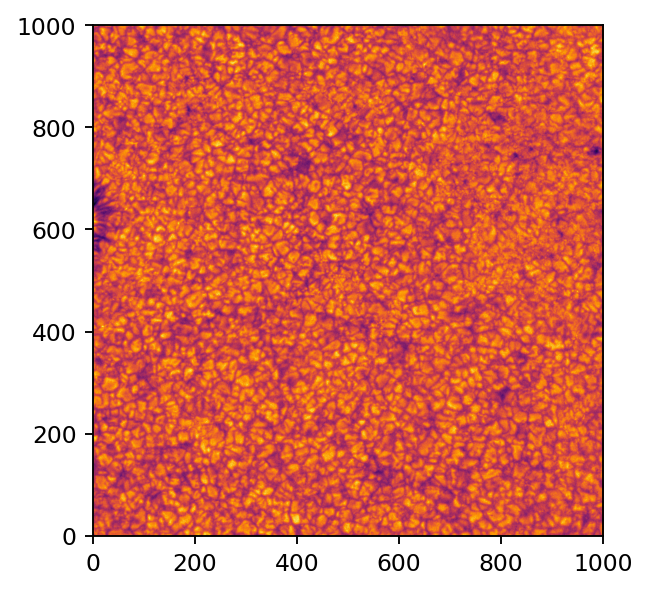

In [74]:
# Visualize test data as an animation.
fig = pl.figure(figsize=(5,4), dpi=169)
ax = pl.subplot(111)
im = pl.imshow(test_data[0], origin='lower', cmap='inferno')
title = ax.set_title('')
ax.set_xlim(0, 1000)
ax.set_ylim(0, 1000)

def draw(n):
    im.set_data(test_data[n])
    title.set_text(f'frame {n}')
    return im

anim = FuncAnimation(fig, draw, frames=11, interval=100)

In [75]:
# Display the animation as a JavaScript widget.
# Note how the image "jitters" from frame to frame; this is what we want to remove.
display.HTML(anim.to_jshtml())

In [79]:
# Perform destretching for each frame, using median as reference.
kernel_sizes = [125, 80, 40, 25]
reference = np.median(test_data, axis=0)
#reference = test_data[5]
ans = np.zeros(test_data.shape)
start = time() 
for i in range(11):
    scene = test_data[i]
    ans[i], disp, rdisp, d_info = reg_loop(scene, reference, kernel_sizes)
    
end = time()
print(f"Time it took is {end-start:.3f} seconds")

Total elapsed time 2.5155 seconds.
Total elapsed time 2.4857 seconds.
Total elapsed time 2.5058 seconds.
Total elapsed time 2.5428 seconds.
Total elapsed time 2.5282 seconds.
Total elapsed time 2.4402 seconds.
Total elapsed time 2.4651 seconds.
Total elapsed time 2.5373 seconds.
Total elapsed time 2.5973 seconds.
Total elapsed time 2.5706 seconds.
Total elapsed time 2.5696 seconds.
Time it took is 27.792 seconds


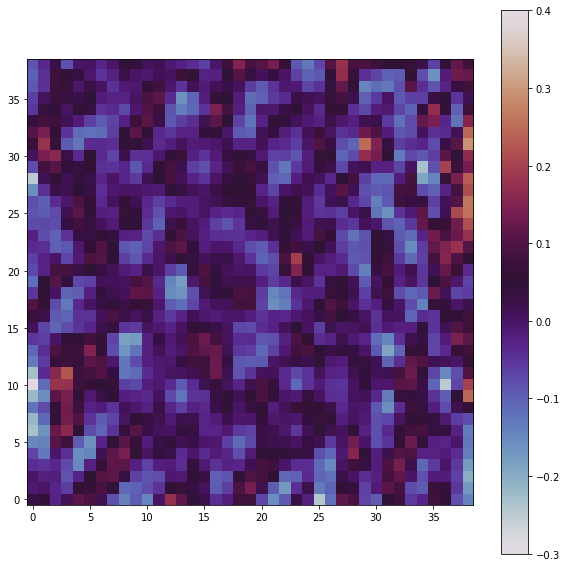

In [37]:
pl.figure(figsize=(10,10))
d = (disp - rdisp)[0]
pl.imshow(np.where(np.abs(d)>0.5,-d,d), origin='lower', vmin=-.3, vmax=.4, cmap='twilight')
pl.colorbar()
#disp

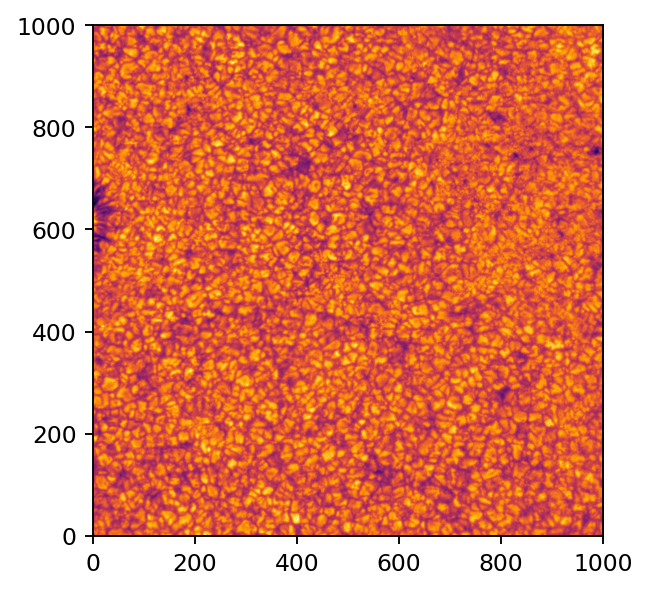

In [41]:
# Create another animation to visualize the destretched data.
fig = pl.figure(figsize=(5,4), dpi=169)
ax = pl.subplot(111)
im = pl.imshow(ans[0], origin='lower', cmap='inferno')
title = ax.set_title('')
ax.set_xlim(0, 1000)
ax.set_ylim(0, 1000)

def draw(n):
    im.set_data(ans[n])
    title.set_text(f'frame {n}')
    return im

anim = FuncAnimation(fig, draw, frames=11, interval=100)

In [42]:
# Once again, we display the animation as a JS widget.
# The "jitter" has been greatly reduced, but some small-scale distortions remain.
display.HTML(anim.to_jshtml())

In [78]:
start = time()
ans, disp, rdisp, d_info = reg_loop_series(test_data.T, reference.T, kernel_sizes)
end = time()
print(f"Elapsed time is {end-start:.3f}")

Total elapsed time 22.7889 seconds.
Elapsed time is 22.848


In [68]:
# Import necessary tools and functions.
from astropy.io import fits
from destretch import *
from matplotlib.animation import FuncAnimation
from IPython import display
pl.rcParams['animation.ffmpeg_path'] = '/usr/local/bin/ffmpeg'